In [36]:
import pandas as pd
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport

In [37]:
df=pd.read_csv("pCR SEIN.csv",encoding= 'unicode_escape')
#df.info()
#df.dtypes
Dates=["Date premeire consultation", "ChimioTTT neo adjuvante -Dates fin","Date de la chirurgie","Rxttt date de debut","DDN","Recidive date","Chimio 2 - Date de fin","ChimioTTT neo adjuvante -Date de debut"]
df=df.drop(columns=Dates)
df.shape




(145, 120)

# One Hot Encoding

In [14]:
#cat_feature = [i for i in df.columns if df[i].dtype not in [np.float, np.int64]]
#for i in cat_feature:
#    print(i,df[i].unique())
id_feature = ["Nom","Prenom","Age"]
cat_feature = [i for i in df.columns if df[i].dtype not in [np.float, np.int64]]
cat_feature=list(set(cat_feature)-set(["Nom", "Prenom"]))
cat_feature1=list(set(cat_feature)-set(['Chimio_2_-_Toxicite', 'Recidive_evolution_deces_ou_0_',
       'Remissions_ou_en_cours_de_trt', 'Cancer_du_sein_Traitement',
       'ATCD_Cancer_du_sien_-_Localisation_',
       'Clinical_localisation_ADP_', 'Chimio_2-_Protocole_et_doses',
       'Chimio_2_-_Nbre_cures_recues', 'Chimio_-_Indication',
       'Chirurgie_-Examen_clinique_avant_chirurgie-_Taille',
       'Biologie_pre_operatoire_-_Ca_15-3',
       'ATCDs_personnels_-_Contraception_-_Typeÿ', 'TNM',
       'Recidive_EVolution_PDV', 'Anapath_piece_pM', 'SI_1_precisez',
       'Echo_-_Micro_calcifications',
       'ATCDs_personnels_-_Contraception_-__Duree_', 'Recidive_trt',
       'ATCDs_familiaux_de_cancer_-_Localisation_de_la_Tm_',
       'ATCDs_familiaux_de_cancer_-__Degre_de_parite',
       'Metastases_-Diagnostic_des_meta_avant_chirurgie_-apres_chirurgie',
       'Metastases_-_Uniques_Multiples']))
cat_feature=list(set(cat_feature)-set(["Nom", "Prenom"]))


    # Print some summary information
#     print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
#         "There are " + str(mis_val_table_ren_columns.shape[0]) +
#           " columns that have missing values.")

    # Return the dataframe with missing information
    return mis_val_table_ren_columns



# Profiling

In [49]:
profile = ProfileReport(df, title='Pandas Profiling Report', html={'style':{'full_width':True}})
profile.to_notebook_iframe()
profile.to_file(output_file="pCR_SEIN_report.html")

# Descriptive Stats

In [22]:
from pygooglechart import PieChart3D

def python_pie3D() :
  # initialize chart object, 250 x 250 pixels
  chart = PieChart3D(250, 250)

  # pass your data to the chart object
  chart.add_data([398, 294, 840, 462])

  # make labels for the slices
  chart.set_pie_labels("Lithuania Bulgaria Ukraine Romania".split())

  # render the image
  chart.download('revenue_east_europe.png')
python_pie3D()

# Missing Values

In [40]:
def missing_values_table(df):
    """Calculate missing values by column, tabulate results

    Input
    df: The dataframe
    """
    # Total missing values
    mis_val = df.isnull().sum()

    # Percentage of missing values
    mis_val_percent = 100 * df.isnull().sum() / len(df)

    # Make a table with the results
    mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)

    # Rename the columns
    mis_val_table_ren_columns = mis_val_table.rename(
    columns = {0 : 'Missing Values', 1 : '% of Total Values'})

    # Sort the table by percentage of missing descending
    mis_val_table_ren_columns = mis_val_table_ren_columns[
        mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)


#missingness=missing_values_table(df)
#missingness_80=list(missingness[missingness["% of Total Values"]>80].index.values)
#df=df.drop(columns=missingness_80)

#missingness[missingness["% of Total Values"]>80].index.values

# Univariate Analysis

In [43]:
df['Age_bins']=pd.cut(df['Age'], 8)
any(pd.isnull(df['Age']))
len(df['Age_bins'].unique())

In [50]:
list(df)

['Nom',
 'Prenom',
 'IP',
 'Age',
 'Statut Marital',
 'Origine',
 'ATCDs personnels ? Diabete',
 'ATCDs personnels - HTAÿ',
 'ATCDs personnels - Dyslipidemie ',
 'ATCDs personnels - Contraception ',
 'ATCDs personnels - Contraception - Typeÿ',
 'ATCDs personnels - Contraception -  Duree ',
 'ATCDs personnels - Parite',
 'ATCDs personnels ? Gestite',
 'ATCD personnels Cancer du sein ',
 'ATCD Cancer du sien - Localisation ',
 'Cancer du sein Traitement',
 'ATCD Autres cancers',
 'ATCDs familiaux de cancer ',
 'ATCDs familiaux de cancer - Localisation de la Tm ',
 'ATCDs familiaux de cancer -  Degre de parite',
 'Menopausee',
 'Menopausee Depuis en annees',
 'CDD-Nodules',
 'CDD-Sx inflammatoires',
 'CDD-Ecoulement mamelonaire',
 'CDD-ADP',
 'CDD- Depistage',
 'CDD-DLR',
 'Unnamed: 30',
 'Delai entre 1er symptome et le diagnostic par mois',
 'Etat general OMS',
 'Poids',
 'Taille',
 'IMC',
 'Clinicial NB lesions S',
 'Clinical Localisation SEIN',
 'Clinical localisation ADP ',
 'Clinicia

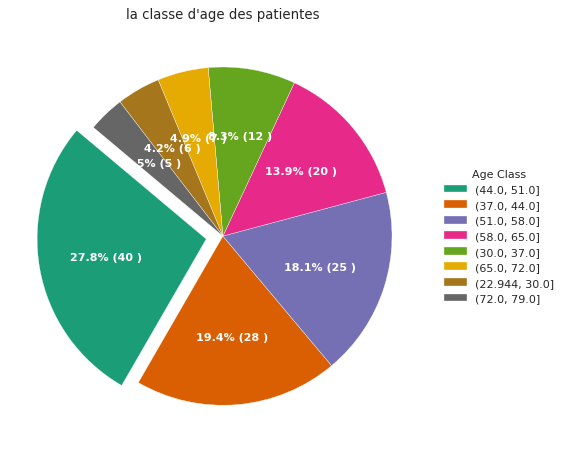

In [48]:
import matplotlib.pyplot as plt
df['Age_bins']=pd.cut(df['Age'], 8)
# Draw Plot
fig, ax = plt.subplots(figsize=(12, 7), subplot_kw=dict(aspect="equal"), dpi= 80)

data =  df['Age_bins'].dropna().value_counts()
categories = data.index
explode = [0.1,0,0,0,0,0,0,0]

def func(pct, allvals):
    absolute = int(pct/100.*np.sum(allvals))
    return "{:.1f}% ({:d} )".format(pct, absolute)

wedges, texts, autotexts = ax.pie(data, 
                                  autopct=lambda pct: func(pct, data),
                                  textprops=dict(color="w"), 
                                  colors=plt.cm.Dark2.colors,
                                 startangle=140,
                                 explode=explode)

# Decoration
ax.legend(wedges, categories, title="Age Class", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.setp(autotexts, size=10, weight=700)
ax.set_title("la classe d'age des patientes")
plt.savefig("Age_Pie_Plot.png")
plt.show()

In [75]:
data.shape

(48,)

# One Hot Encoding

In [35]:
one_hot=pd.get_dummies(df1, prefix_sep="_", columns=cat_feature1)
df=df.merge(one_hot, how='left', on=id_feature)

In [36]:
list(one_hot)

['Nom',
 'Prenom',
 'Age',
 'Reponse au ttt_P',
 'Reponse au ttt_RC',
 'Reponse au ttt_RP',
 'Reponse au ttt_S',
 'Rxttt indication_ADJ',
 'Rxttt indication_compression medu',
 'Rxttt indication_meta cerebral',
 'Type histologique_CCI',
 'Type histologique_CINOS',
 'Type histologique_CLI',
 'Type histologique_Carcinome micropapllaire',
 'Type histologique_Carcinome mucineux inf',
 'Type histologique_Carcinome peu diff',
 'Type histologique_Lymphangite carcinomateuse',
 'Nombre de mitose 10 champ_10',
 'Nombre de mitose 10 champ_14',
 'Nombre de mitose 10 champ_15',
 'Nombre de mitose 10 champ_17',
 'Nombre de mitose 10 champ_20',
 'Nombre de mitose 10 champ_25',
 'Nombre de mitose 10 champ_30',
 'Nombre de mitose 10 champ_6',
 'Nombre de mitose 10 champ_7',
 'Nombre de mitose 10 champ_8',
 'Nombre de mitose 10 champ_nombreux',
 'Nombre de mitose 10 champ_peu nombreuse',
 'Nombre de mitose 10 champ_rare',
 'Echo ADP axillaires NB_0',
 'Echo ADP axillaires NB_1',
 'Echo ADP axillaires NB

In [37]:
df.dtypes
cat_feature = [i for i in df.columns if df[i].dtype not in [np.float, np.int64,np.uint8]]
cat_feature

['Nom',
 'Prenom',
 'Statut Marital',
 'Origine',
 'Clinical Localisation SEIN',
 'Echo - Localisation ',
 'Echo ADP axillaires NB',
 'Type biopsie',
 'Type histologique',
 'Nombre de mitose 10 champ',
 'HER 2',
 'EV',
 'ChimioTTT neo adjuvante -Indication',
 'ChimioTTT neo adjuvante - Protocoles et doses',
 'ChimioTTT neo adjuvante -Toxicites',
 'Reponse a la chimio P/S/RP/ RC',
 'chirurgie conservatrice- Radicale',
 'Anapath piece type histo',
 'Anapath piece  marges d exrese',
 'Anapath piece EV',
 'Anapath piece  EPN',
 'Score de Sataloff Sein',
 'Score de Sataloff Gg',
 'Rxttt indication',
 'Rxttt site d irradiation',
 'Hormonottt protocole',
 'Reponse au ttt',
 'Recidive siege']

In [38]:
df=df.drop(columns=cat_feature)

In [39]:
df=df.drop(columns=["IP"])

In [41]:
df.shape

(155, 284)

# Shap

In [ ]:
import os
# Requirement in order to import xgboost
mingw_path = 'C:\\Program Files\\mingw-w64\\x86_64-6.1.0-posix-seh-rt_v5-rev0\\mingw64\\bin'
os.environ['PATH'] = mingw_path + ';' + os.environ['PATH']

#import all relevant libraries
import xgboost as xgb
from xgboost.sklearn import XGBClassifier
from xgboost import plot_importance
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, roc_curve, auc
from scipy import interp

%matplotlib inline

In [221]:
df.shape
df.to_csv("df.csv")

In [230]:
x_df = df.drop(columns=["pCR"])
y_df = df[["pCR"]]

In [231]:
y_df  

,pCR
0,1
1,0
2,0
3,0
4,0
...,...
150,1
151,0
152,0
153,0


In [234]:
# Define the class weight scale (a hyperparameter) as the ration of negative labels to positive labels.
# This instructs the classifier to address the class imbalance.
class_weight_scale = 1.*y_df.pCR.value_counts()[0]/y_df.pCR.value_counts()[1]
class_weight_scale

4.0

In [236]:
# Setting minimal required initial hyperparameters

param={
    'objective':'binary:logistic',
    'nthread':4,
    'scale_pos_weight':class_weight_scale,
    'seed' : 1   
}
xgb1 = XGBClassifier()
xgb1.set_params(**param)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=4, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=4.0, seed=1,
              silent=None, subsample=1, verbosity=1)

class weight scale : 4.142857142857143
class weight scale : 3.9655172413793105
class weight scale : 3.9655172413793105
class weight scale : 3.9655172413793105
class weight scale : 3.9655172413793105
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0


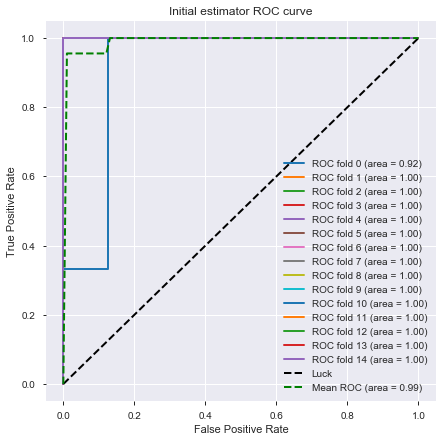

In [239]:
# Train initial classifier and analyze performace using K-fold cross-validation 
K = 15
eval_size = int(np.round(1./K))
skf = StratifiedKFold(n_splits=K, shuffle = True)

fig = plt.figure(figsize=(7,7))
mean_tpr = 0.0
mean_fpr = np.linspace(0, 1, 100)
lw = 2
i = 0
roc_aucs_xgb1 = []
for train_indices, test_indices in skf.split(x_df, y_df['pCR']):
    X_train, y_train = x_df.iloc[train_indices], y_df['pCR'].iloc[train_indices]
    X_valid, y_valid = x_df.iloc[test_indices], y_df['pCR'].iloc[test_indices]
    class_weight_scale = 1.*y_train.value_counts()[0]/y_train.value_counts()[1]
    print ('class weight scale : {}'.format(class_weight_scale))
    xgb1.set_params(**{'scale_pos_weight' : class_weight_scale})
    xgb1.fit(X_train,y_train)
    xgb1_pred_prob = xgb1.predict_proba(X_valid)
    fpr, tpr, thresholds = roc_curve(y_valid, xgb1_pred_prob[:, 1])
    mean_tpr += interp(mean_fpr, fpr, tpr)
    mean_tpr[0] = 0.0
    roc_auc = auc(fpr, tpr)
    roc_aucs_xgb1.append(roc_auc)
    plt.plot(fpr, tpr, lw=2, label='ROC fold %d (area = %0.2f)' % (i, roc_auc))

    i += 1
    
plt.plot([0, 1], [0, 1], linestyle='--', lw=lw, color='k',
         label='Luck')

mean_tpr /= K
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
plt.plot(mean_fpr, mean_tpr, color='g', linestyle='--',
         label='Mean ROC (area = %0.2f)' % mean_auc, lw=lw)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Initial estimator ROC curve')
plt.legend(loc="lower right")

fig.savefig('initial_ROC.png')

In [240]:
# Option to perform hyperparameter optimization. Otherwise loads pre-defined xgb_opt params
optimize = True

In [241]:
X_train = x_df
y_train = y_df['pCR']

if optimize:
   
    param_test0 = {
     'n_estimators':range(50,250,10)
    }
    print ('performing hyperparamter optimization step 0')
    gsearch0 = GridSearchCV(estimator = xgb1, param_grid = param_test0, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
    gsearch0.fit(X_train,y_train)
    print (gsearch0.best_params_, gsearch0.best_score_)

    param_test1 = {
     'max_depth':range(1,10),
     'min_child_weight':range(1,10)
    }
    print ('performing hyperparamter optimization step 1')
    gsearch1 = GridSearchCV(estimator = gsearch0.best_estimator_,
     param_grid = param_test1, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
    gsearch1.fit(X_train,y_train)
    print (gsearch1.best_params_, gsearch1.best_score_)

    max_d = gsearch1.best_params_['max_depth']
    min_c = gsearch1.best_params_['min_child_weight']
    
    param_test2 = {
     'gamma':[i/10. for i in range(0,5)]
    }
    print ('performing hyperparamter optimization step 2')
    gsearch2 = GridSearchCV(estimator = gsearch1.best_estimator_, 
     param_grid = param_test2, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
    gsearch2.fit(X_train,y_train)
    print (gsearch2.best_params_, gsearch2.best_score_)

    param_test3 = {
        'subsample':[i/10.0 for i in range(1,10)],
        'colsample_bytree':[i/10.0 for i in range(1,10)]
    }
    print ('performing hyperparamter optimization step 3')
    gsearch3 = GridSearchCV(estimator = gsearch2.best_estimator_, 
     param_grid = param_test3, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
    gsearch3.fit(X_train,y_train)
    print (gsearch3.best_params_, gsearch3.best_score_)

    param_test4 = {
        'reg_alpha':[0, 1e-5, 1e-3, 0.1, 10]
    }
    print ('performing hyperparamter optimization step 4')
    gsearch4 = GridSearchCV(estimator = gsearch3.best_estimator_, 
     param_grid = param_test4, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
    gsearch4.fit(X_train,y_train)
    print (gsearch4.best_params_, gsearch4.best_score_)

    alpha = gsearch4.best_params_['reg_alpha']
    if alpha != 0:
        param_test4b = {
            'reg_alpha':[0.1*alpha, 0.25*alpha, 0.5*alpha, alpha, 2.5*alpha, 5*alpha, 10*alpha]
        }
        print ('performing hyperparamter optimization step 4b')
        gsearch4b = GridSearchCV(estimator = gsearch4.best_estimator_, 
         param_grid = param_test4b, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
        gsearch4b.fit(X_train,y_train)
        print (gsearch4b.best_params_, gsearch4.best_score_)
        print ('\nParameter optimization finished!')
        xgb_opt = gsearch4b.best_estimator_
        xgb_opt
    else:
        xgb_opt = gsearch4.best_estimator_
        xgb_opt
else: 
    # Pre-optimized settings
    xgb_opt = XGBClassifier(base_score=0.5, colsample_bylevel=1, colsample_bytree=0.7,
       gamma=0.1, learning_rate=0.1, max_delta_step=0, max_depth=3,
       min_child_weight=5, missing=None, n_estimators=70, nthread=4,
       objective='binary:logistic', reg_alpha=25.0, reg_lambda=1,
       scale_pos_weight=7.0909090909090908, seed=1, silent=True,
       subsample=0.6)
    
print (xgb_opt)

performing hyperparamter optimization step 0
{'n_estimators': 120} 0.988857142857143
performing hyperparamter optimization step 1
{'max_depth': 1, 'min_child_weight': 2} 0.9939047619047618
performing hyperparamter optimization step 2
{'gamma': 0.0} 0.9939047619047618
performing hyperparamter optimization step 3
{'colsample_bytree': 0.1, 'subsample': 0.6} 0.9986666666666666
performing hyperparamter optimization step 4
{'reg_alpha': 0} 0.9986666666666666
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.1, gamma=0.0,
              learning_rate=0.1, max_delta_step=0, max_depth=1,
              min_child_weight=2, missing=None, n_estimators=120, n_jobs=1,
              nthread=4, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=4.0, seed=1,
              silent=None, subsample=0.6, verbosity=1)


class weight scale : 4.148148148148148
class weight scale : 3.9642857142857144
class weight scale : 3.9642857142857144
class weight scale : 3.9642857142857144
class weight scale : 3.9642857142857144
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0
class weight scale : 4.0


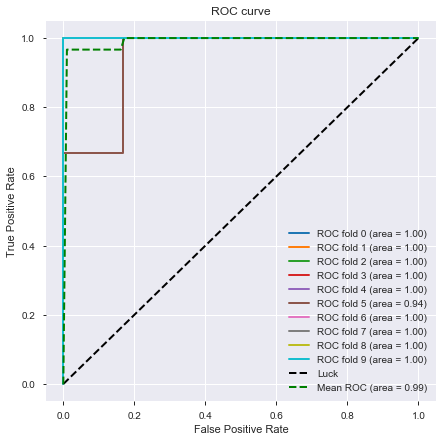

In [247]:
K = 10
eval_size = int(np.round(1./K))
skf = StratifiedKFold(n_splits=K)


fig = plt.figure(figsize=(7,7))
mean_tpr = 0.0
mean_fpr = np.linspace(0, 1, 100)
lw = 2
i = 0
roc_aucs_xgbopt = []
for train_indices, test_indices in skf.split(x_df, y_df['pCR']):
    X_train, y_train = x_df.iloc[train_indices], y_df['pCR'].iloc[train_indices]
    X_valid, y_valid = x_df.iloc[test_indices], y_df['pCR'].iloc[test_indices]
    class_weight_scale = 1.*y_train.value_counts()[0]/y_train.value_counts()[1]
    print ('class weight scale : {}'.format(class_weight_scale))
    xgb_opt.set_params(**{'scale_pos_weight' : class_weight_scale})
    xgb_opt.fit(X_train,y_train)
    xgb_opt_pred_prob = xgb_opt.predict_proba(X_valid)
    fpr, tpr, thresholds = roc_curve(y_valid, xgb_opt_pred_prob[:, 1])
    mean_tpr += interp(mean_fpr, fpr, tpr)
    mean_tpr[0] = 0.0
    roc_auc = auc(fpr, tpr)
    roc_aucs_xgbopt.append(roc_auc)
    plt.plot(fpr, tpr, lw=2, label='ROC fold %d (area = %0.2f)' % (i, roc_auc))

    i += 1
    
plt.plot([0, 1], [0, 1], linestyle='--', lw=lw, color='k',
         label='Luck')

mean_tpr /= K
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
plt.plot(mean_fpr, mean_tpr, color='g', linestyle='--',
         label='Mean ROC (area = %0.2f)' % mean_auc, lw=lw)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right")

fig.savefig('ROC.png')

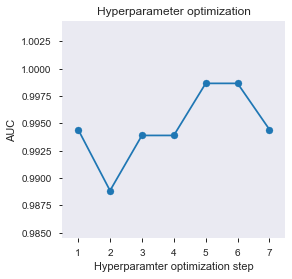

In [248]:
if optimize:
    
    aucs = [np.mean(roc_aucs_xgb1),
            gsearch0.best_score_,
            gsearch1.best_score_,
            gsearch2.best_score_,
            gsearch3.best_score_,
            gsearch4.best_score_,
            np.mean(roc_aucs_xgbopt)]
    
    fig = plt.figure(figsize=(4,4))
    plt.scatter(np.arange(1,len(aucs)+1), aucs)
    plt.plot(np.arange(1,len(aucs)+1), aucs)
    plt.xlim([0.5, len(aucs)+0.5])
    plt.ylim([0.99*aucs[0], 1.01*aucs[-1]])
    plt.xlabel('Hyperparamter optimization step')
    plt.ylabel('AUC')
    plt.title('Hyperparameter optimization')
    plt.grid()
    fig.savefig('optimization.png')

In [250]:
print (classification_report(y_true = y_df.pCR, y_pred = np.zeros(y_df.shape[0])))

              precision    recall  f1-score   support

           0       0.80      1.00      0.89       124
           1       0.00      0.00      0.00        31

    accuracy                           0.80       155
   macro avg       0.40      0.50      0.44       155
weighted avg       0.64      0.80      0.71       155



In [251]:
print(classification_report(y_true = y_df.pCR, y_pred = xgb_opt.predict(x_df)))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99       124
           1       0.94      1.00      0.97        31

    accuracy                           0.99       155
   macro avg       0.97      0.99      0.98       155
weighted avg       0.99      0.99      0.99       155



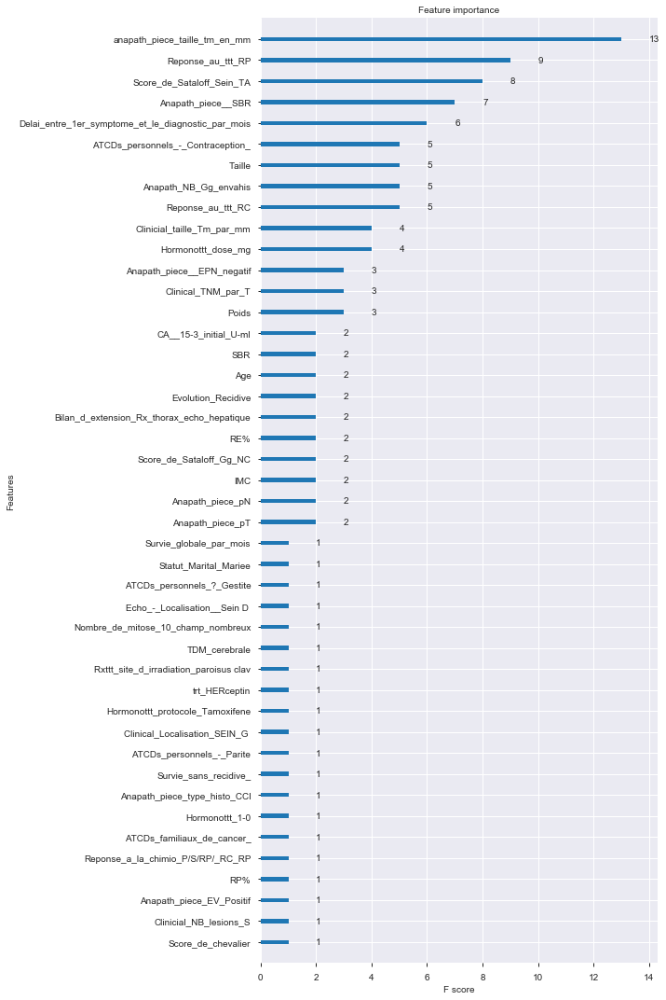

In [253]:
def my_plot_importance(booster, figsize, **kwargs): 
    from matplotlib import pyplot as plt
    from xgboost import plot_importance
    fig, ax = plt.subplots(1,1,figsize=(figsize))
    plot_importance(booster=booster, ax=ax, **kwargs)
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label,] +
ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(10)
    plt.tight_layout()
    fig.savefig('Feature_importance.png')

my_plot_importance(xgb_opt, (10,15))

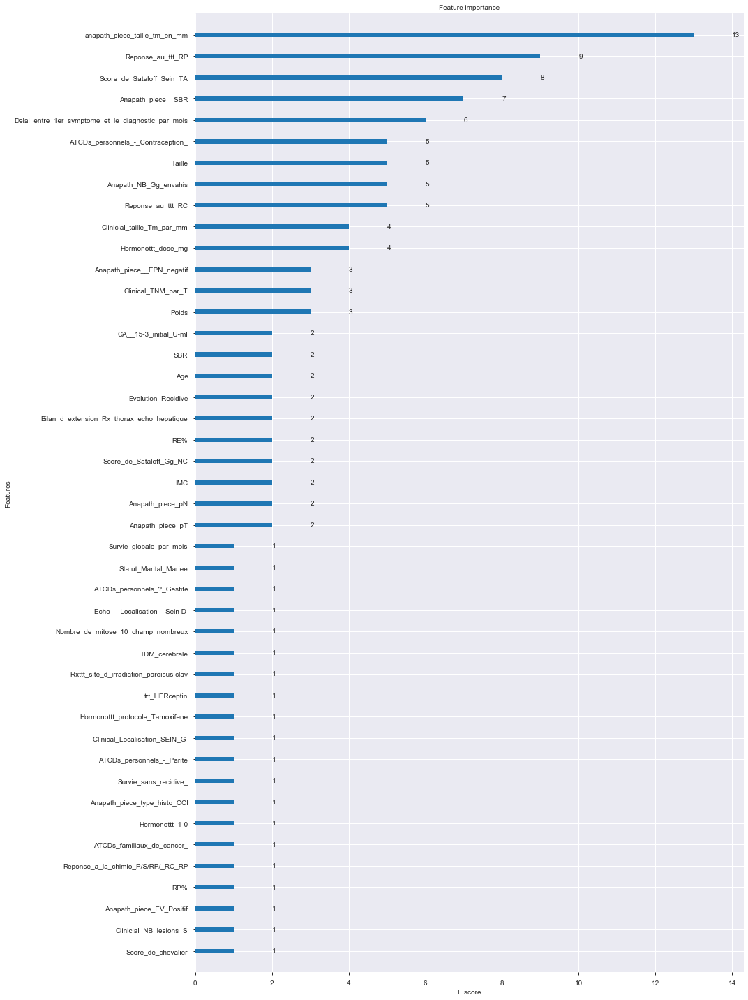

In [279]:
xgb_opt.predict_proba(X_train.iloc[2:3])

array([[0.9455225 , 0.05447753]], dtype=float32)

In [290]:
import xgboost
import shap

# load JS visualization code to notebook
shap.initjs()

# train XGBoost model
#X,y = shap.datasets.boston()
#model = xgboost.train({"learning_rate": 0.01}, xgboost.DMatrix(X, label=y), 100)

# explain the model's predictions using SHAP values
# (same syntax works for LightGBM, CatBoost, scikit-learn and spark models)
explainer = shap.TreeExplainer(xgb_opt)
shap_values = explainer.shap_values(X_train)

# visualize the first prediction's explanation (use matplotlib=True to avoid Javascript)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:])

In [291]:
explainer = shap.TreeExplainer(xgb_opt)

# Calculate Shap values for team_A and team_B
shap_values_A = explainer.shap_values(X_train.iloc[2:3])
shap.force_plot(explainer.expected_value, shap_values_A, X_train.iloc[2:3])

In [256]:
#visualize the training set predictions
shap.force_plot(explainer.expected_value, shap_values, X_train)

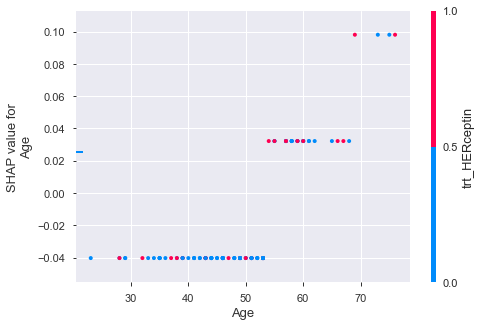

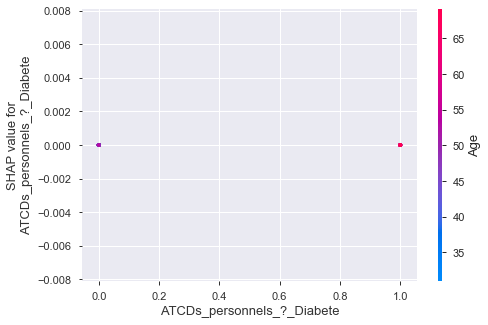

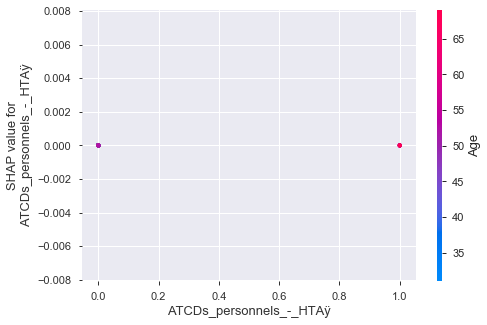

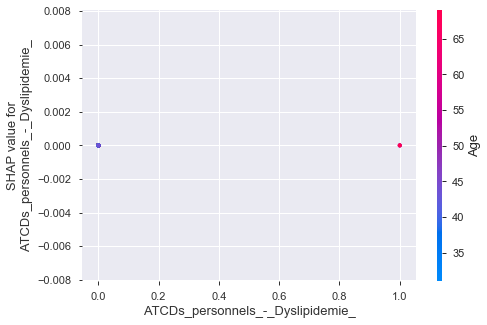

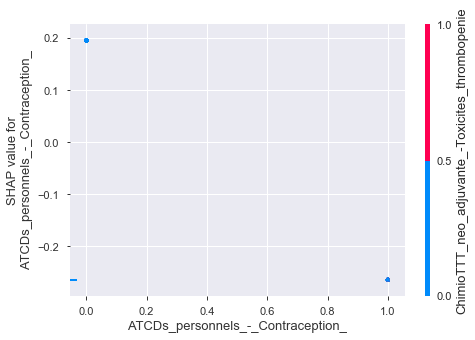

...

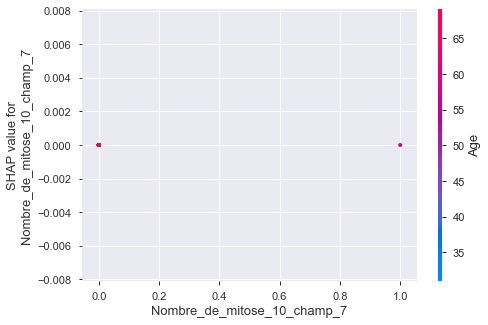

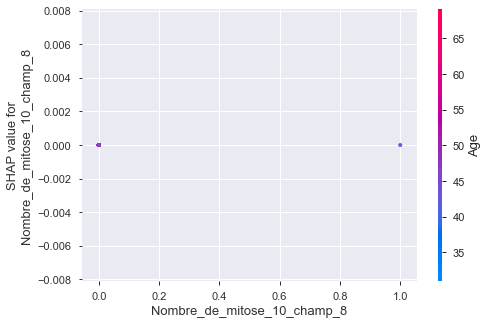

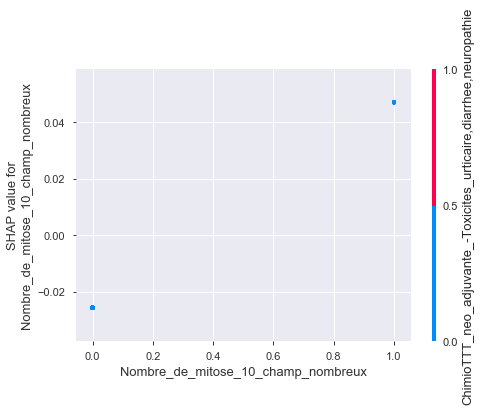

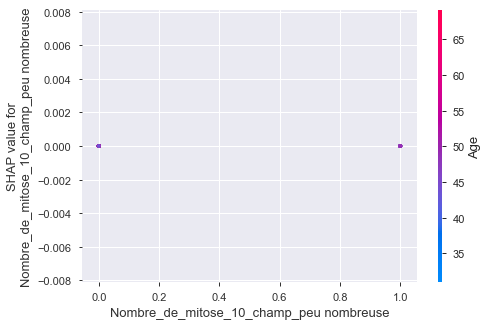

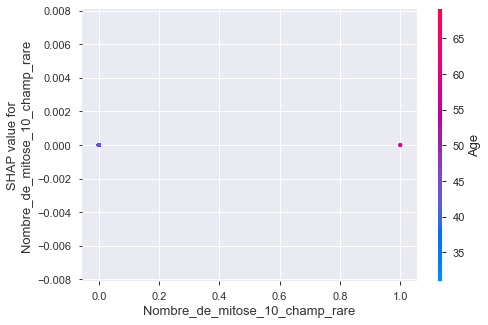

In [259]:
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
for fea in list(X_train):
    shap.dependence_plot(fea, shap_values, X_train)

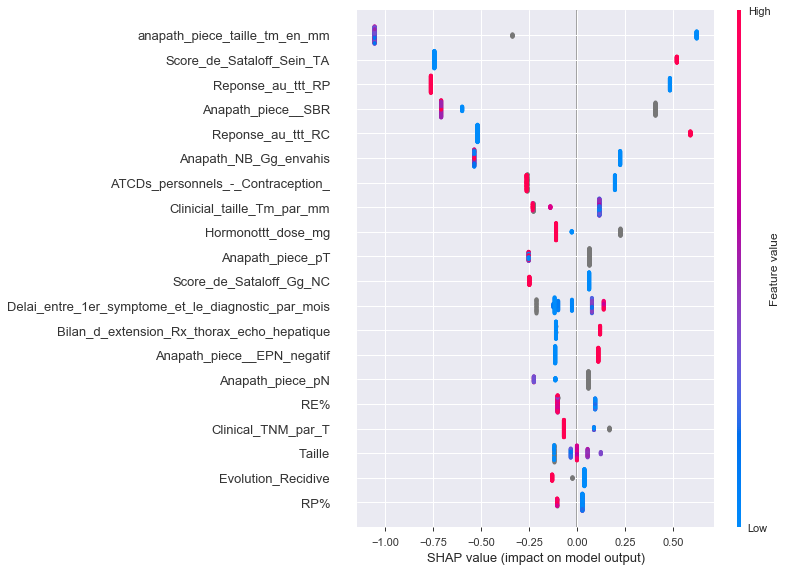

In [260]:
# summarize the effects of all the features
shap.summary_plot(shap_values, X_train)

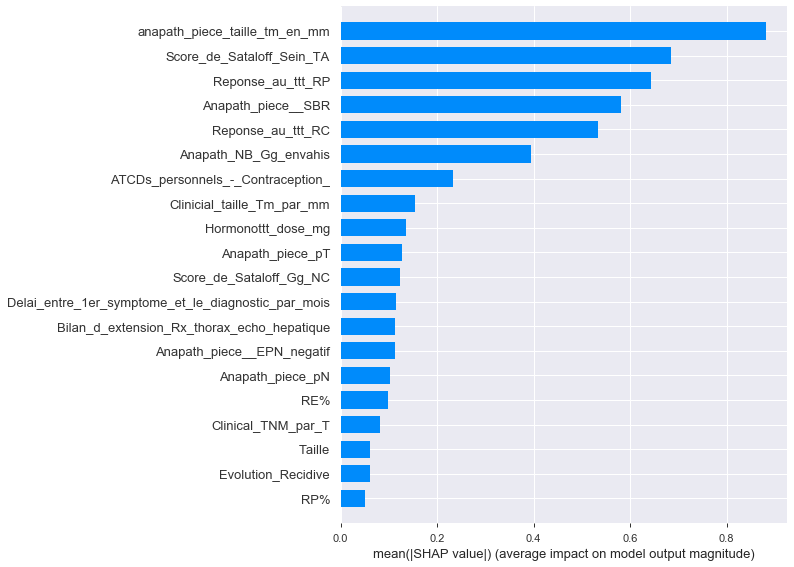

In [261]:
shap.summary_plot(shap_values, X_train, plot_type="bar")

In [263]:
# def ABS_SHAP(df_shap,df):
#     #import matplotlib as plt
#     # Make a copy of the input data
#     shap_v = pd.DataFrame(df_shap)
#     feature_list = df.columns
#     shap_v.columns = feature_list
#     df_v = df.copy().reset_index().drop('index',axis=1)
    
#     # Determine the correlation in order to plot with different colors
#     corr_list = list()
#     for i in feature_list:
#         b = np.corrcoef(shap_v[i],df_v[i])[1][0]
#         corr_list.append(b)
#     corr_df = pd.concat([pd.Series(feature_list),pd.Series(corr_list)],axis=1).fillna(0)
#     # Make a data frame. Column 1 is the feature, and Column 2 is the correlation coefficient
#     corr_df.columns  = ['Variable','Corr']
#     corr_df['Sign'] = np.where(corr_df['Corr']>0,'red','blue')
    
#     # Plot it
#     shap_abs = np.abs(shap_v)
#     k=pd.DataFrame(shap_abs.mean()).reset_index()
#     k.columns = ['Variable','SHAP_abs']
#     k2 = k.merge(corr_df,left_on = 'Variable',right_on='Variable',how='inner')
#     k2 = k2.sort_values(by='SHAP_abs',ascending = True)
#     colorlist = k2['Sign']
#     ax = k2.plot.barh(x='Variable',y='SHAP_abs',color = colorlist, figsize=(5,6),legend=False)
#     ax.set_xlabel("SHAP Value (Red = Positive Impact)")
    
# ABS_SHAP(shap_values,X_train) 

In [270]:
from sklearn.base import clone 
import seaborn as sns
def drop_col_feat_imp(model, X_train, y_train, random_state = 42):
    
    # clone the model to have the exact same specification as the one initially trained
    model_clone = clone(model)
    # set random_state for comparability
    model_clone.random_state = random_state
    # training and scoring the benchmark model
    model_clone.fit(X_train, y_train)
    benchmark_score = model_clone.score(X_train, y_train)
    # list for storing feature importances
    importances = []
    
    # iterating over all columns and storing feature importance (difference between benchmark and new model)
    for col in X_train.columns:
        #print(col)
        model_clone = clone(model)
        model_clone.random_state = random_state
        model_clone.fit(X_train.drop(col, axis = 1), y_train)
        drop_col_score = model_clone.score(X_train.drop(col, axis = 1), y_train)
        importances.append(benchmark_score - drop_col_score)
    
    importances_df = imp_df(X_train.columns, importances)
    return importances_df
# udfs ----
from matplotlib import rcParams
# function for creating a feature importance dataframe
def imp_df(column_names, importances):
    df = pd.DataFrame({'feature': column_names,
                       'feature_importance': importances}) \
           .sort_values('feature_importance', ascending = False) \
           .reset_index(drop = True)
    return df

# plotting a feature importance dataframe (horizontal barchart)
def var_imp_plot(imp_df, title):
    imp_df.columns = ['feature', 'feature_importance']
    sns_plot=sns.barplot(x = 'feature_importance', y = 'feature', data = imp_df, orient = 'h', color = 'royalblue').set_title(title, fontsize = 20)
    rcParams['figure.figsize'] = 22,19
    fig = sns_plot.get_figure()
    fig.savefig(title+"png")
    plt.close(fig)

In [268]:
drop_imp = drop_col_feat_imp(xgb_opt, x_df, y_df)

In [271]:
var_imp_plot(drop_imp, "Feature importance")

In [ ]:
# import shap  # package used to calculate Shap values

# Team_A = 5
# Team_B = 7

# data_for_prediction_A = val_X.iloc[Team_A] 
# data_for_prediction_array_A = data_for_prediction_A.values.reshape(1, -1)

# data_for_prediction_B = val_X.iloc[Team_B]  
# data_for_prediction_array_B = data_for_prediction_B.values.reshape(1, -1)


# # Create object that can calculate shap values
# explainer = shap.TreeExplainer(model)

# # Calculate Shap values for team_A and team_B
# shap_values_A = explainer.shap_values(data_for_prediction_A)
# shap_values_B = explainer.shap_values(data_for_prediction_B)

# # predicted probabilities for each outcome
# prob_A = my_model.predict_proba(data_for_prediction_array_A)
# prob_B = my_model.predict_proba(data_for_prediction_array_B)

# print('prob to choose the man of the match from Team_A: ',prob_A)
# print('prob to choose the man of the match from Team_B: ',prob_B)
# #################################################################
# prob to choose the man of the match from Team_A:  [[ 0.3  0.7]]
# prob to choose the man of the match from Team_B:  [[ 0.4  0.6]]

In [ ]:
# # SHAP Value visualization for team A
# shap.initjs()
# shap.force_plot(explainer.expected_value[1], shap_values_A[1], data_for_prediction_A)

# # SHAP Value visualization for team B
# shap.force_plot(explainer.expected_value[1], shap_values_B[1], data_for_prediction_B)